<a href="https://colab.research.google.com/github/hamzaraouzi/Generative_adversial_Networks/blob/main/WGAN_GP_face.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch
import torchvision 
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def imshow(img):
    img =img.cpu()
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

In [ ]:
def weights_initialization(model):
  for m in model.modules():
    if isinstance(m,(nn.Conv2d, nn.ConvTranspose2d,nn.BatchNorm2d)):
      nn.init.normal_(m.weight.data,0.0,0.02)


In [ ]:
class Discriminator(nn.Module):
  def __init__(self, channels_img, features_d):
    super(Discriminator,self).__init__()
    self.disc  = nn.Sequential(
        nn.Conv2d(
            channels_img, features_d, kernel_size=4, stride=2,padding=1
        ),
        nn.LeakyReLU(0.2),
        self.block(features_d  , features_d*2   , 4, 2, 1),
        self.block(features_d*2, features_d*4 , 4, 2, 1),
        self.block(features_d*4, features_d*8 , 4, 2, 1),
        
        nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0)
    )

  def block(self,in_channels, out_channels,kernel_size,stride, padding):
    return nn.Sequential(
        nn.Conv2d(in_channels, out_channels,kernel_size,stride, padding,
                  bias=False),
        nn.InstanceNorm2d(out_channels, affine=True),
        nn.LeakyReLU(0.2)
    )

  def forward(self, x):
    return self.disc(x)

In [ ]:
x = torch.rand((5,1,64,64))
disc = Discriminator(1,64)
y = disc(x)
print(y.shape)

torch.Size([5, 1, 1, 1])


In [ ]:
class Generator(nn.Module):
    def __init__(self, channels_noise, channels_img, features_g):
        super(Generator, self).__init__()
        self.net = nn.Sequential(
            # Input: N x channels_noise x 1 x 1

            self.block(channels_noise, features_g * 16, 4, 1, 0),  # img: 4x4
            self.block(features_g * 16, features_g * 8, 4, 2, 1),  # img: 8x8
            self.block(features_g * 8, features_g * 4, 4, 2, 1),  # img: 16x16
            self.block(features_g * 4, features_g * 2, 4, 2, 1),  # img: 32x32
            nn.ConvTranspose2d(
                features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
            ),
            # Output: N x channels_img x 64 x 64
            nn.Tanh(),
        )

    def block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels,
                out_channels,
                kernel_size,
                stride,
                padding,
                bias=False,
            ),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
        )

    def forward(self, x):
        return self.net(x)


In [ ]:
x = torch.rand((5,100,1,1))
gen = Generator(100,1,64)
y = gen(x)
print(y.shape)

torch.Size([5, 1, 64, 64])


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import torchvision

LEARNING_RATE = 1e-4
BATCH_SIZE = 64
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
NUM_EPOCHS = 100
FEATURES_CRITIC = 16
FEATURES_GEN = 16
CRITIC_ITERATIONS = 5
LAMBDA_GP = 10



transform = transforms.Compose([transforms.Resize((IMAGE_SIZE,IMAGE_SIZE)),
                                transforms.ToTensor(),
                                transforms.Normalize([0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)])])
                                



In [ ]:
from google.colab import files
files.upload()

In [ ]:
!mkdir -p ~/.kaggle
!cp  kaggle.json  ~/.kaggle
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d jessicali9530/celeba-dataset

 98% 1.31G/1.33G [00:09<00:00, 186MB/s]
100% 1.33G/1.33G [00:09<00:00, 147MB/s]


In [ ]:
from zipfile import ZipFile
file_name="celeba-dataset.zip"
with ZipFile(file_name,"r") as zip :
  zip.extractall()
  print('Done')

Done


In [ ]:
dataset = datasets.ImageFolder('img_align_celeba/',  
                                    transform=transform)  
dataloader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


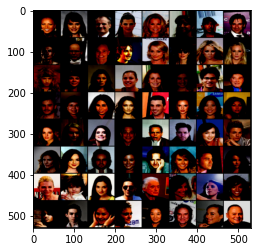

torch.Size([64, 3, 64, 64])


In [ ]:
dataiter = iter(dataloader)
images, labels = dataiter.next()

# show images
imshow(torchvision.utils.make_grid(images))
print(images.shape)

In [ ]:

gen = Generator(Z_DIM,CHANNELS_IMG,FEATURES_GEN).to(device)
critic = Discriminator(CHANNELS_IMG, FEATURES_CRITIC).to(device)

weights_initialization(gen)
weights_initialization(disc)

In [ ]:
def gradient_penalty(critic, real, fake, device="cpu"):
    BATCH_SIZE, C, H, W = real.shape
    alpha = torch.rand((BATCH_SIZE, 1, 1, 1)).repeat(1, C, H, W).to(device)

    interpolated_images = real * alpha + fake * (1 - alpha)

    # Calculate critic scores
    mixed_scores = critic(interpolated_images)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty


Epoch [0/100] Batch 100/3166                   Loss D: -8.0662, loss G: 112.5332


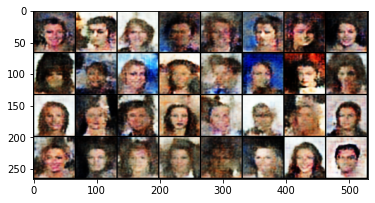

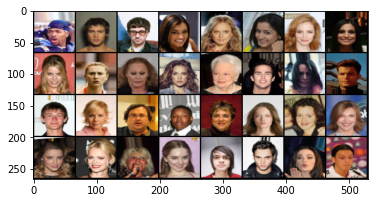

Epoch [0/100] Batch 200/3166                   Loss D: -7.1910, loss G: 106.3475


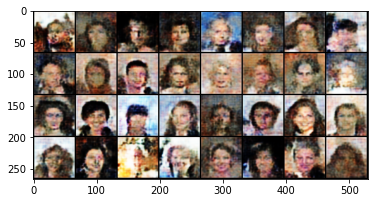

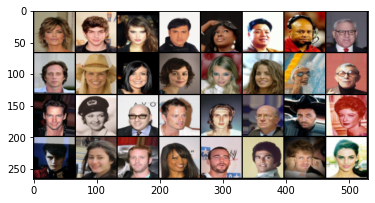

Epoch [0/100] Batch 300/3166                   Loss D: -8.9505, loss G: 115.7377


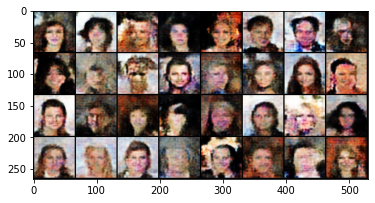

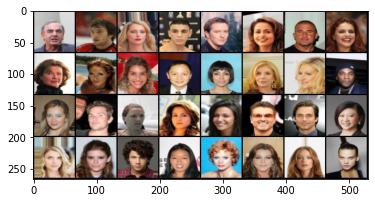

Epoch [0/100] Batch 400/3166                   Loss D: -11.9887, loss G: 106.4579


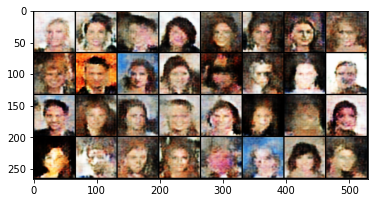

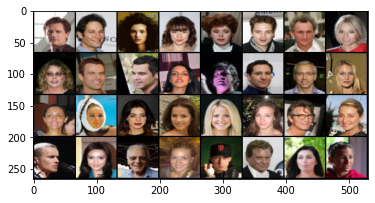

Epoch [0/100] Batch 500/3166                   Loss D: -9.8266, loss G: 103.8486


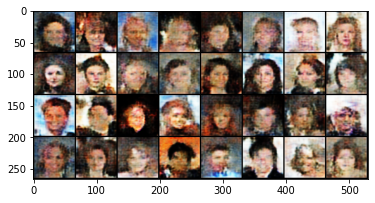

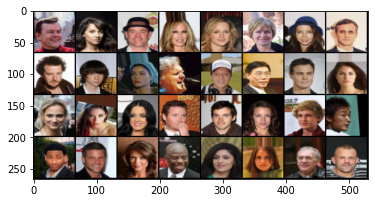

Epoch [0/100] Batch 600/3166                   Loss D: -8.4383, loss G: 105.9414


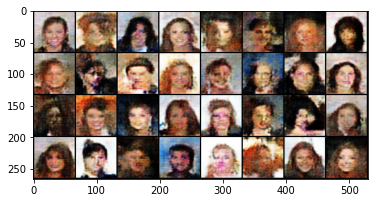

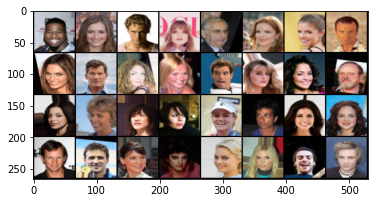

Epoch [0/100] Batch 700/3166                   Loss D: -10.0790, loss G: 115.9398


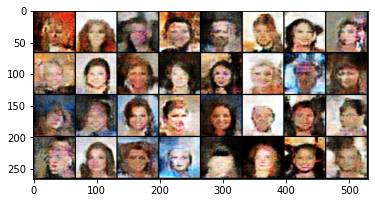

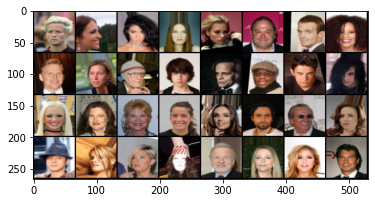

Epoch [0/100] Batch 800/3166                   Loss D: -8.1391, loss G: 117.9032


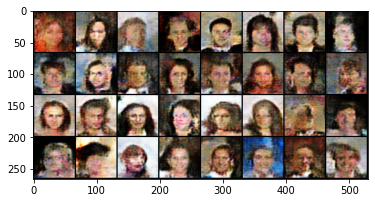

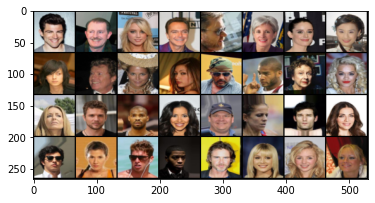

Epoch [0/100] Batch 900/3166                   Loss D: -7.5409, loss G: 115.3487


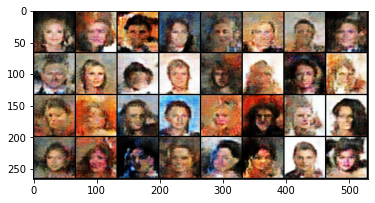

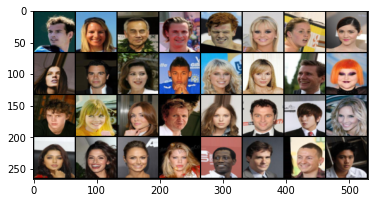

Epoch [0/100] Batch 1000/3166                   Loss D: -7.9161, loss G: 112.2786


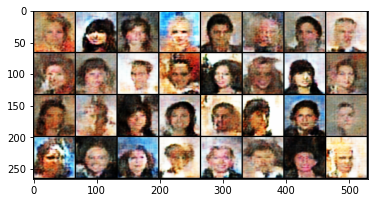

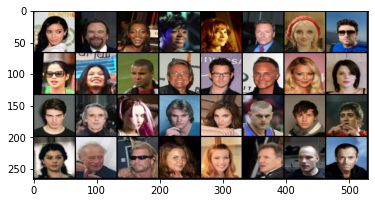

Epoch [0/100] Batch 1100/3166                   Loss D: -7.7360, loss G: 115.6712


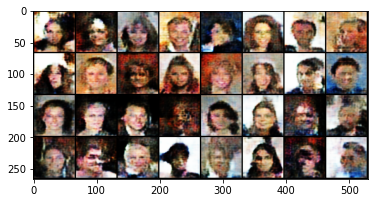

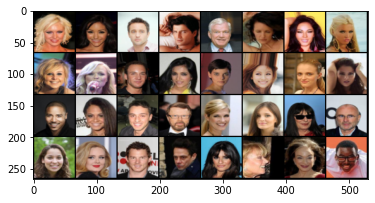

Epoch [0/100] Batch 1200/3166                   Loss D: -6.9804, loss G: 108.9807


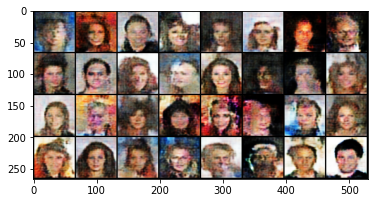

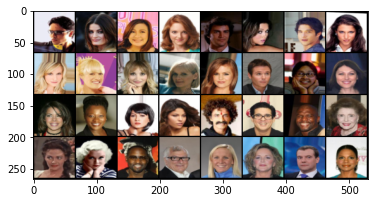

Epoch [0/100] Batch 1300/3166                   Loss D: -6.6684, loss G: 114.1242


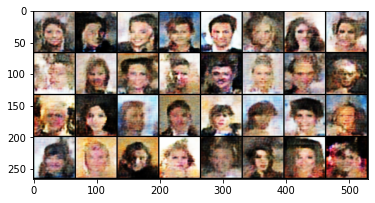

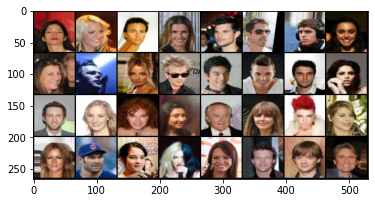

Epoch [0/100] Batch 1400/3166                   Loss D: -6.4959, loss G: 116.9811


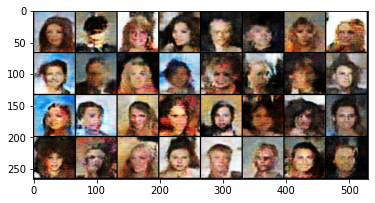

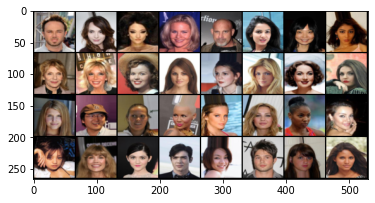

Epoch [0/100] Batch 1500/3166                   Loss D: -7.1616, loss G: 121.7892


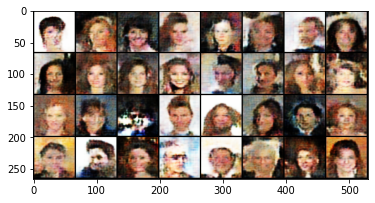

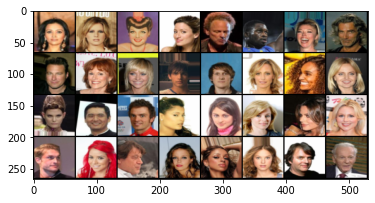

Epoch [0/100] Batch 1600/3166                   Loss D: -7.0352, loss G: 111.1961


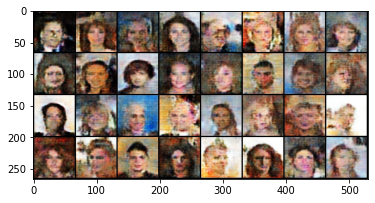

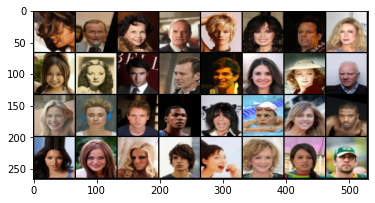

Epoch [0/100] Batch 1700/3166                   Loss D: -8.6933, loss G: 118.5243


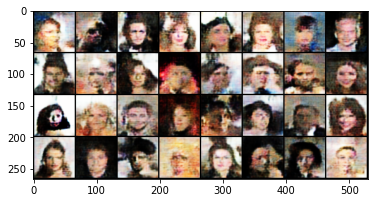

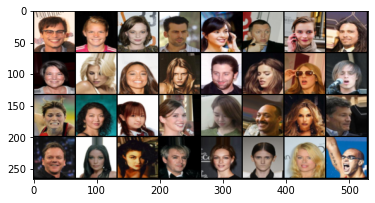

Epoch [0/100] Batch 1800/3166                   Loss D: -6.5108, loss G: 104.0192


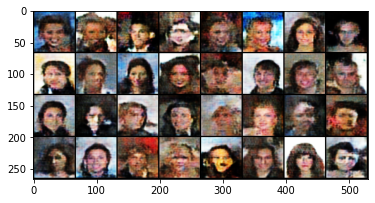

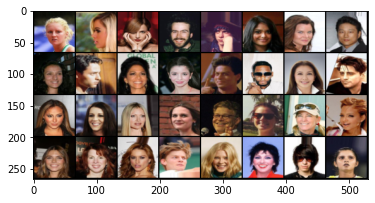

Epoch [0/100] Batch 1900/3166                   Loss D: -6.7260, loss G: 116.1735


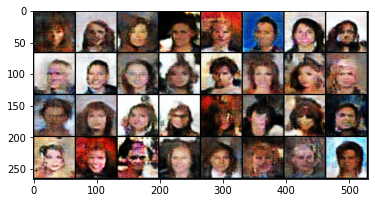

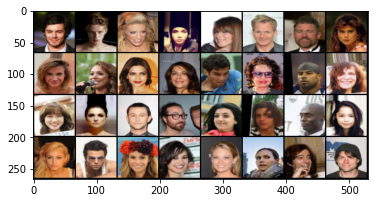

Epoch [0/100] Batch 2000/3166                   Loss D: -6.8597, loss G: 115.5117


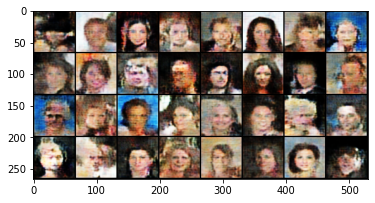

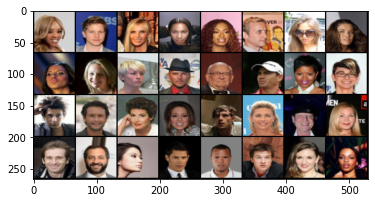

Epoch [0/100] Batch 2100/3166                   Loss D: -8.6665, loss G: 109.1574


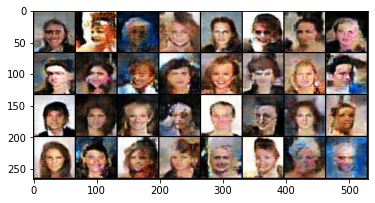

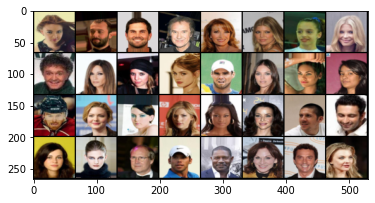

Epoch [0/100] Batch 2200/3166                   Loss D: -6.7143, loss G: 113.1340


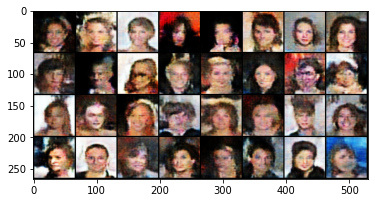

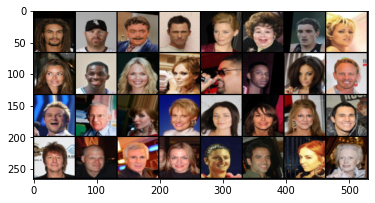

Epoch [0/100] Batch 2300/3166                   Loss D: -9.6882, loss G: 108.0375


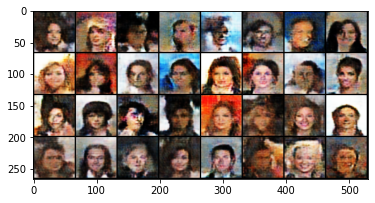

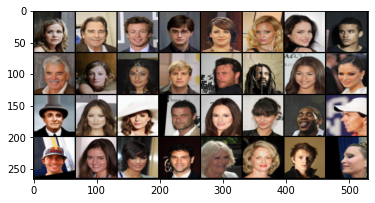

Epoch [0/100] Batch 2400/3166                   Loss D: -7.7434, loss G: 119.5548


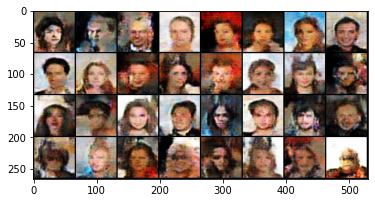

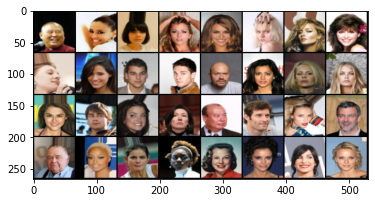

Epoch [0/100] Batch 2500/3166                   Loss D: -8.2239, loss G: 108.9038


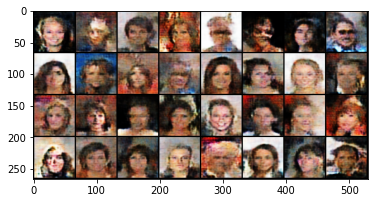

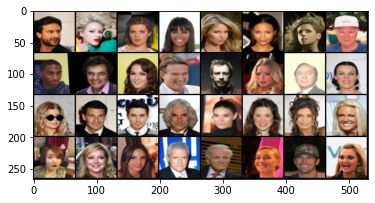

Epoch [0/100] Batch 2600/3166                   Loss D: -6.2952, loss G: 115.8316


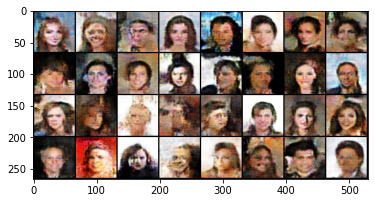

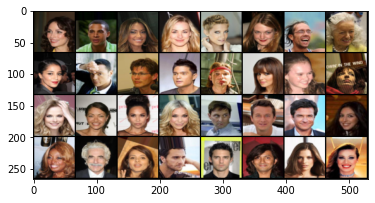

Epoch [0/100] Batch 2700/3166                   Loss D: -8.8140, loss G: 118.2745


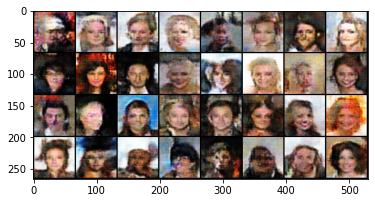

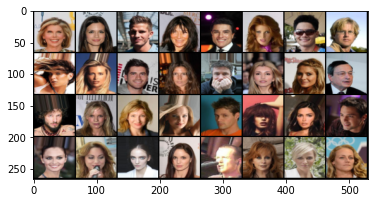

Epoch [0/100] Batch 2800/3166                   Loss D: -7.3703, loss G: 112.7660


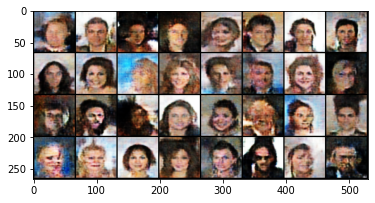

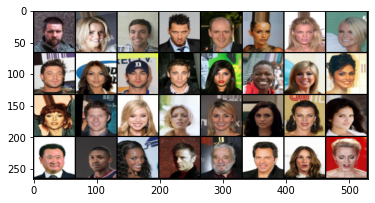

Epoch [0/100] Batch 2900/3166                   Loss D: -6.6911, loss G: 115.0930


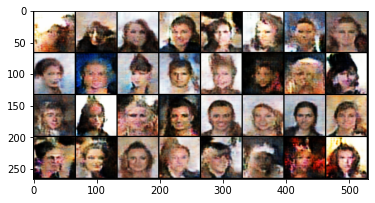

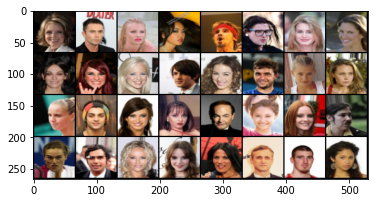

Epoch [0/100] Batch 3000/3166                   Loss D: -6.8739, loss G: 120.6603


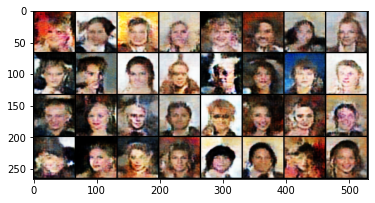

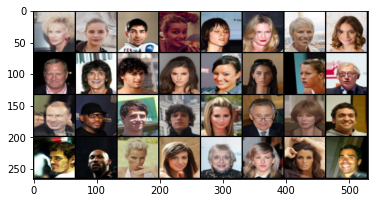

Epoch [0/100] Batch 3100/3166                   Loss D: -7.8591, loss G: 115.1505


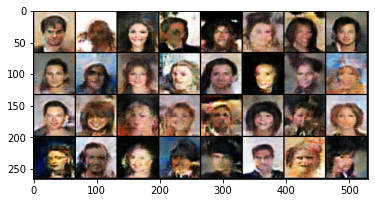

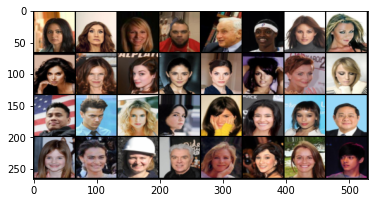

Epoch [1/100] Batch 100/3166                   Loss D: -6.2411, loss G: 118.0494


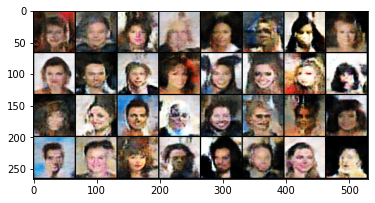

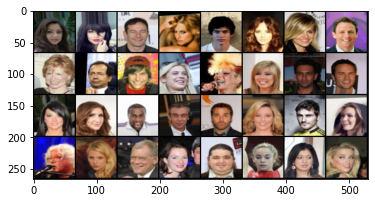

Epoch [1/100] Batch 200/3166                   Loss D: -5.6908, loss G: 113.0989


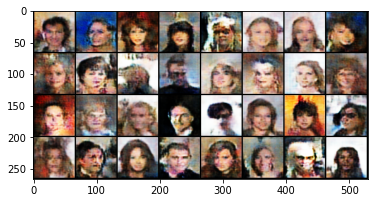

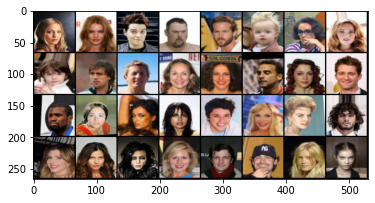

Epoch [1/100] Batch 300/3166                   Loss D: -4.9012, loss G: 116.0008


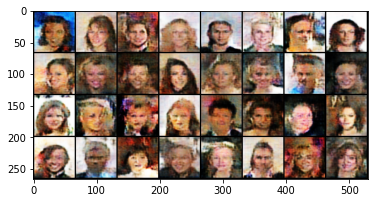

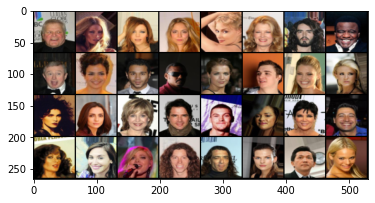

Epoch [1/100] Batch 400/3166                   Loss D: -6.8899, loss G: 116.3683


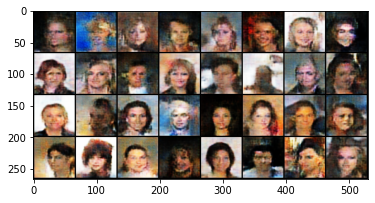

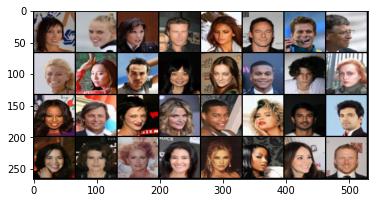

Epoch [1/100] Batch 500/3166                   Loss D: -5.5777, loss G: 121.3763


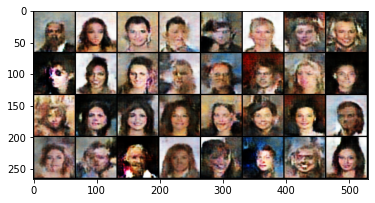

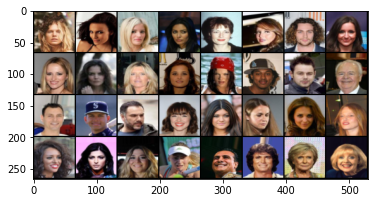

Epoch [1/100] Batch 600/3166                   Loss D: -8.1086, loss G: 135.5271


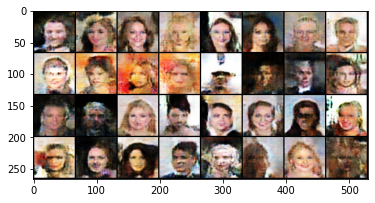

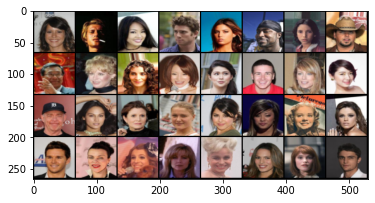

Epoch [1/100] Batch 700/3166                   Loss D: -6.5039, loss G: 121.5199


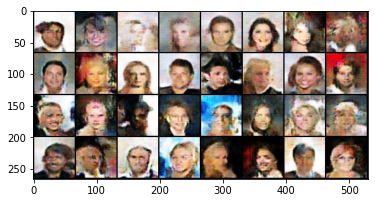

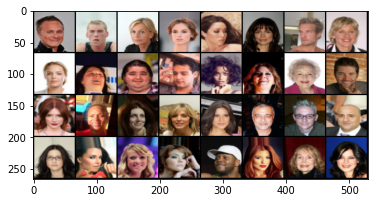

Epoch [1/100] Batch 800/3166                   Loss D: -6.0559, loss G: 117.1169


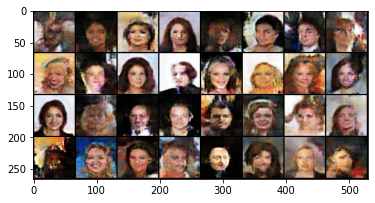

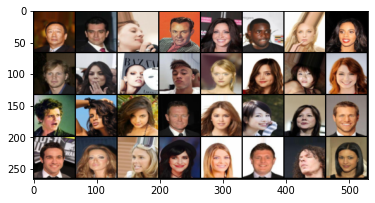

Epoch [1/100] Batch 900/3166                   Loss D: -6.2837, loss G: 118.1132


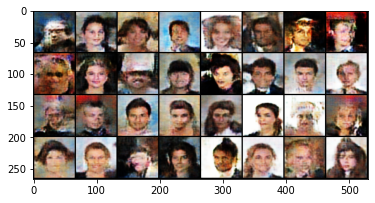

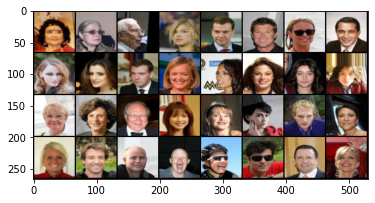

Epoch [1/100] Batch 1000/3166                   Loss D: -6.2980, loss G: 113.1558


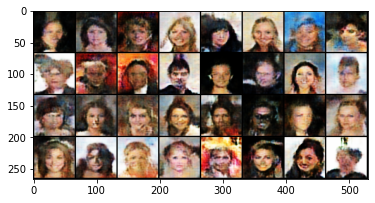

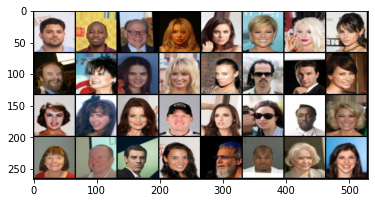

Epoch [1/100] Batch 1100/3166                   Loss D: -6.0502, loss G: 112.3654


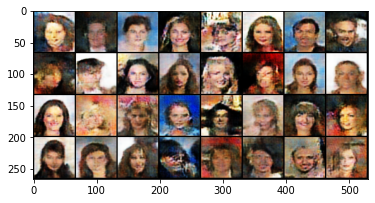

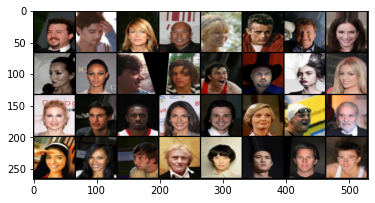

Epoch [1/100] Batch 1200/3166                   Loss D: -7.0504, loss G: 112.3933


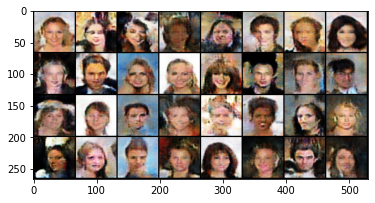

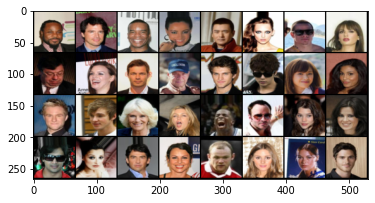

Epoch [1/100] Batch 1300/3166                   Loss D: -5.3067, loss G: 127.9620


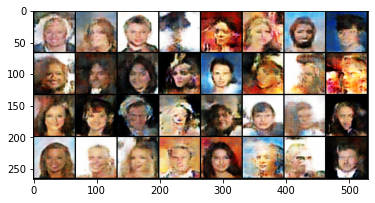

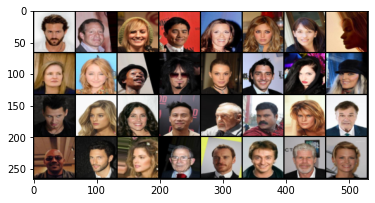

Epoch [1/100] Batch 1400/3166                   Loss D: -6.8663, loss G: 121.4556


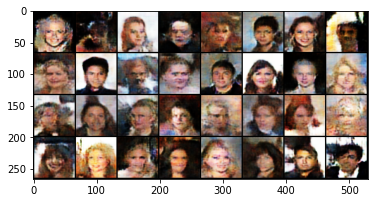

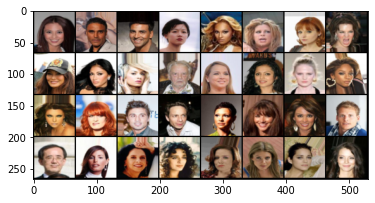

Epoch [1/100] Batch 1500/3166                   Loss D: -6.4410, loss G: 122.2148


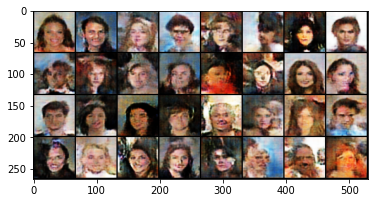

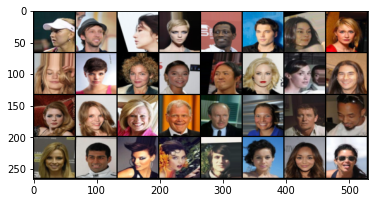

Epoch [1/100] Batch 1600/3166                   Loss D: -5.5686, loss G: 117.2855


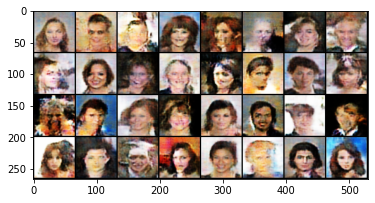

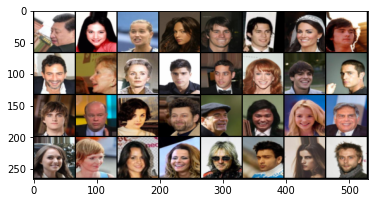

Epoch [1/100] Batch 1700/3166                   Loss D: -5.1050, loss G: 119.1212


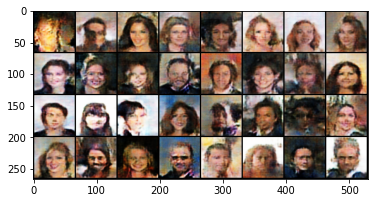

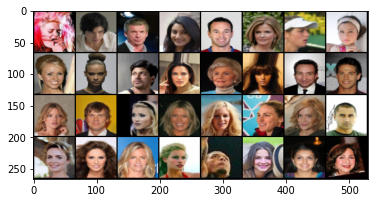

Epoch [1/100] Batch 1800/3166                   Loss D: -5.2073, loss G: 118.4363


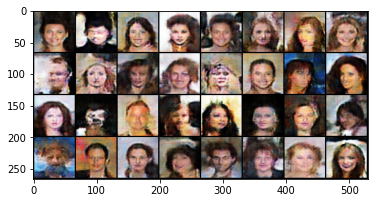

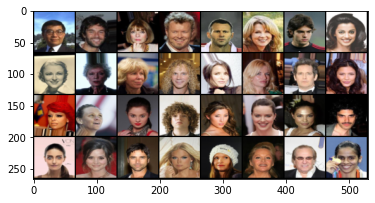

Epoch [1/100] Batch 1900/3166                   Loss D: -7.8036, loss G: 114.8251


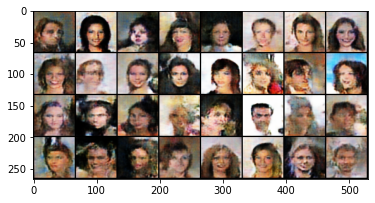

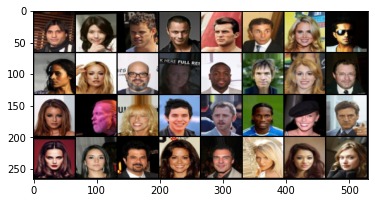

Epoch [1/100] Batch 2000/3166                   Loss D: -6.1615, loss G: 119.1653


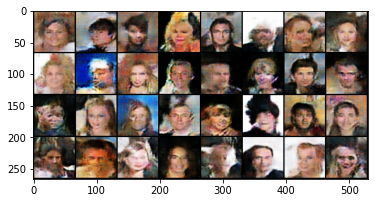

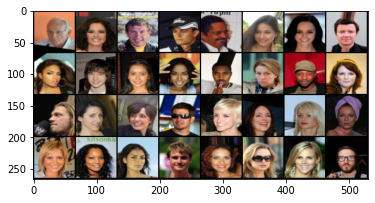

Epoch [1/100] Batch 2100/3166                   Loss D: -5.6039, loss G: 110.0304


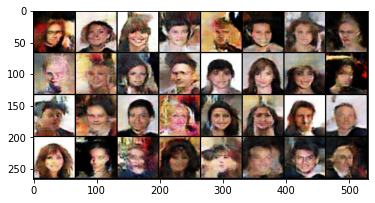

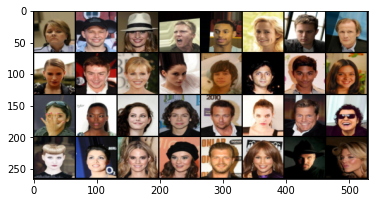

Epoch [1/100] Batch 2200/3166                   Loss D: -7.8058, loss G: 105.0776


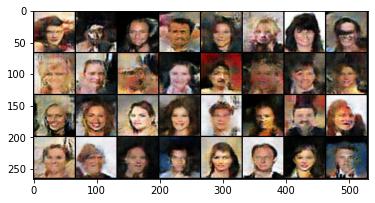

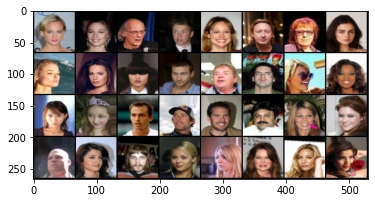

Epoch [1/100] Batch 2300/3166                   Loss D: -6.3844, loss G: 116.3201


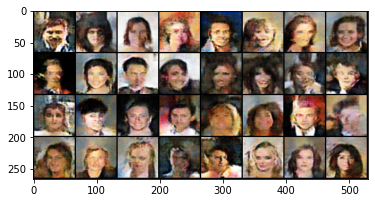

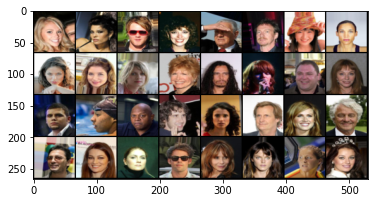

Epoch [1/100] Batch 2400/3166                   Loss D: -6.4275, loss G: 123.7485


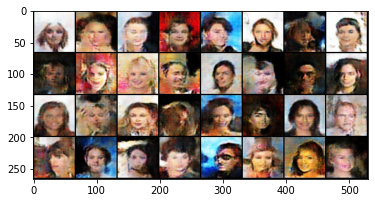

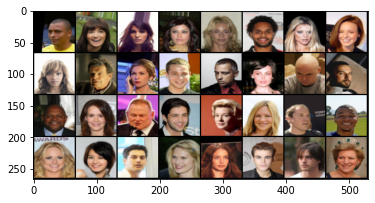

Epoch [1/100] Batch 2500/3166                   Loss D: -4.9396, loss G: 108.8074


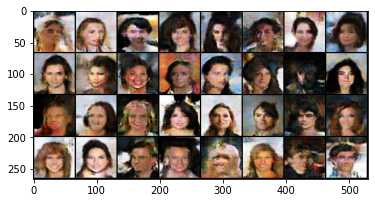

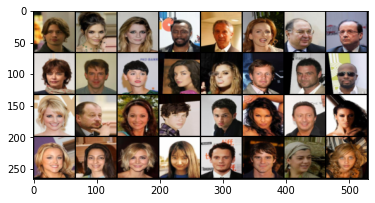

Epoch [1/100] Batch 2600/3166                   Loss D: -5.5102, loss G: 118.9504


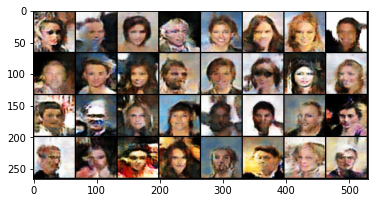

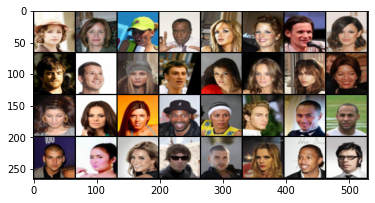

Epoch [1/100] Batch 2700/3166                   Loss D: -4.1585, loss G: 123.2436


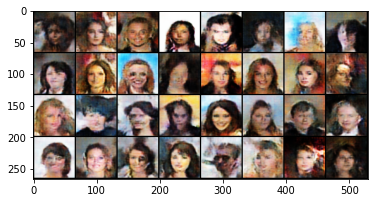

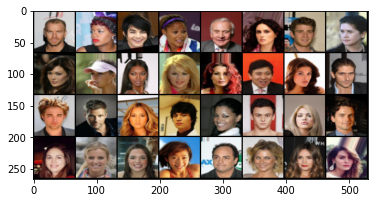

Epoch [1/100] Batch 2800/3166                   Loss D: -5.1884, loss G: 119.5400


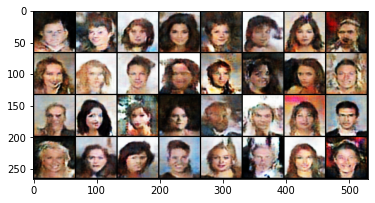

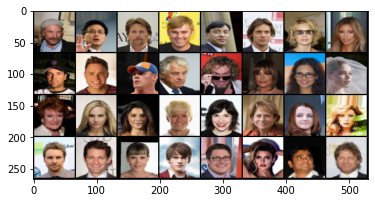

Epoch [1/100] Batch 2900/3166                   Loss D: -5.3303, loss G: 124.2174


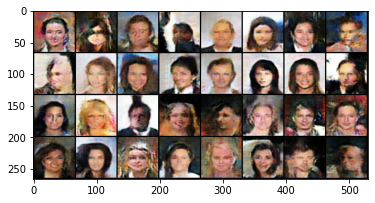

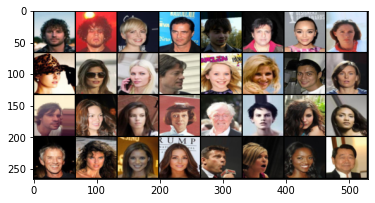

Epoch [1/100] Batch 3000/3166                   Loss D: -4.8164, loss G: 119.5806


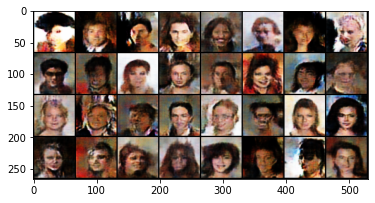

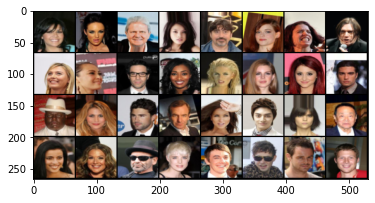

Epoch [1/100] Batch 3100/3166                   Loss D: -7.3572, loss G: 128.0049


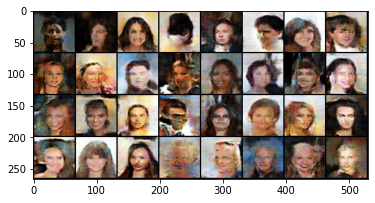

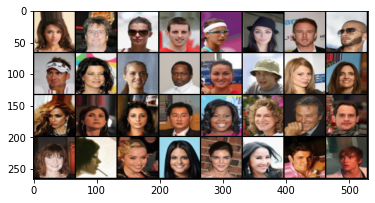

Epoch [2/100] Batch 100/3166                   Loss D: -7.1696, loss G: 113.2426


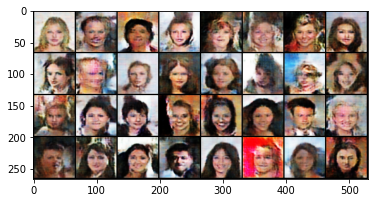

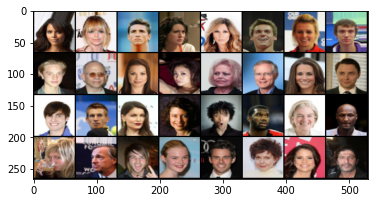

Epoch [2/100] Batch 200/3166                   Loss D: -6.3144, loss G: 127.3443


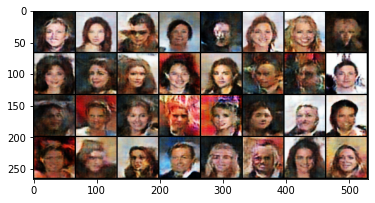

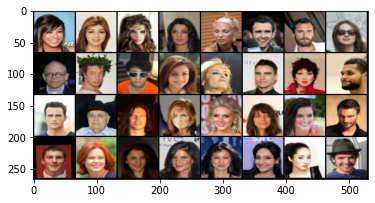

Epoch [2/100] Batch 300/3166                   Loss D: -7.6107, loss G: 120.9461


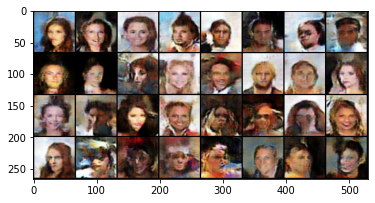

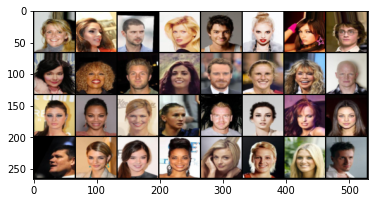

Epoch [2/100] Batch 400/3166                   Loss D: -5.5641, loss G: 113.5285


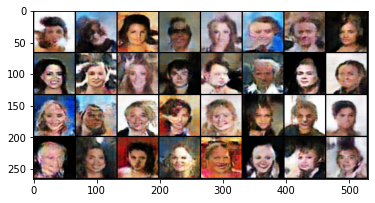

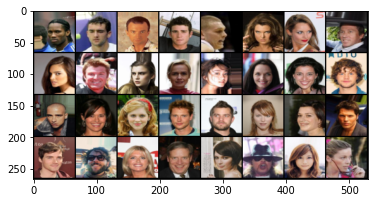

Epoch [2/100] Batch 500/3166                   Loss D: -5.6644, loss G: 119.9859


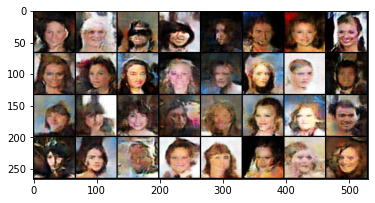

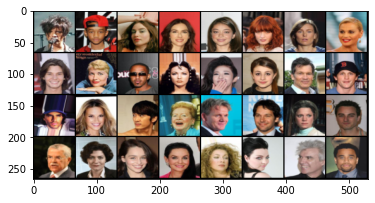

Epoch [2/100] Batch 600/3166                   Loss D: -4.4196, loss G: 118.7633


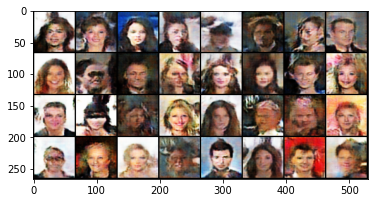

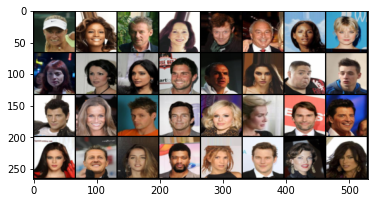

Epoch [2/100] Batch 700/3166                   Loss D: -4.3147, loss G: 121.7409


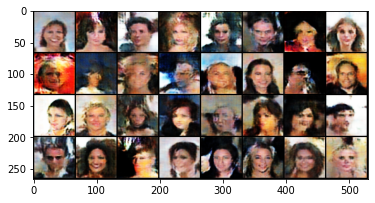

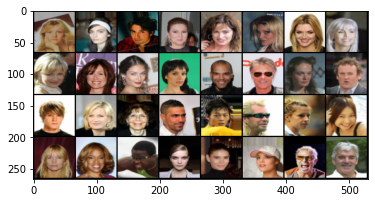

Epoch [2/100] Batch 800/3166                   Loss D: -4.4289, loss G: 119.3903


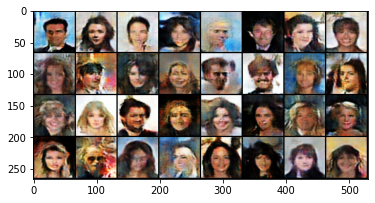

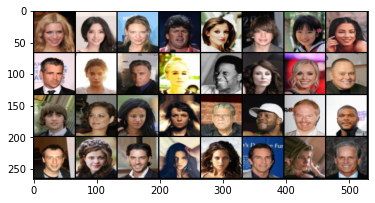

Epoch [2/100] Batch 900/3166                   Loss D: -4.0390, loss G: 120.0919


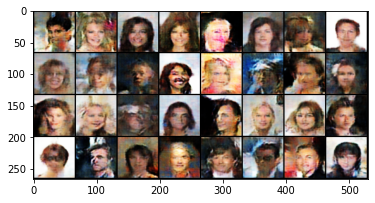

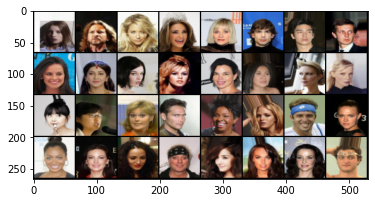

Epoch [2/100] Batch 1000/3166                   Loss D: -4.9933, loss G: 115.5910


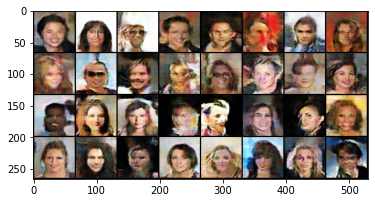

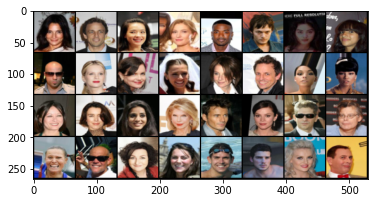

Epoch [2/100] Batch 1100/3166                   Loss D: -5.8356, loss G: 123.3959


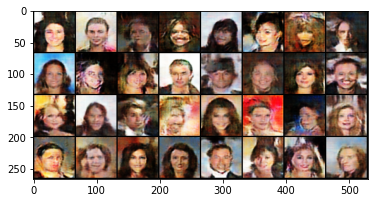

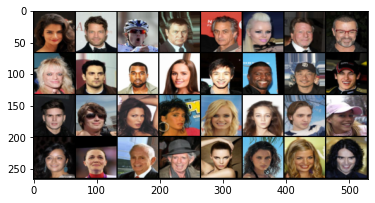

Epoch [2/100] Batch 1200/3166                   Loss D: -3.7566, loss G: 124.9087


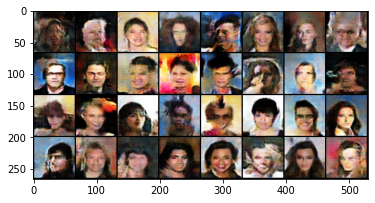

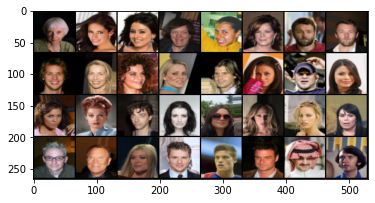

Epoch [2/100] Batch 1300/3166                   Loss D: -5.7148, loss G: 129.5117


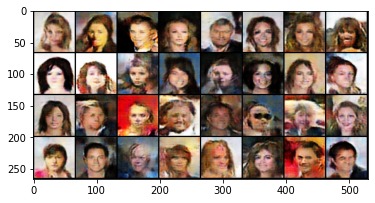

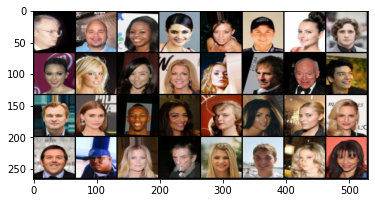

Epoch [2/100] Batch 1400/3166                   Loss D: -5.4566, loss G: 125.9008


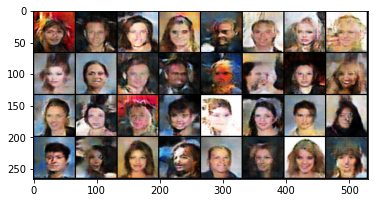

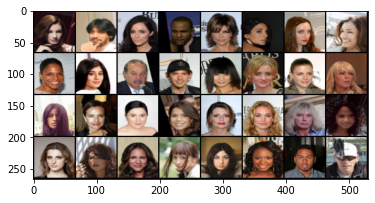

Epoch [2/100] Batch 1500/3166                   Loss D: -3.0299, loss G: 122.7124


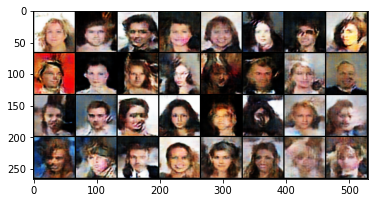

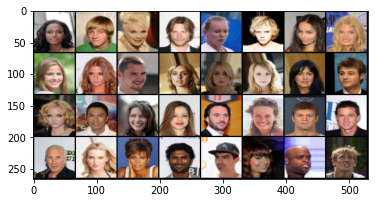

Epoch [2/100] Batch 1600/3166                   Loss D: -3.9330, loss G: 123.8325


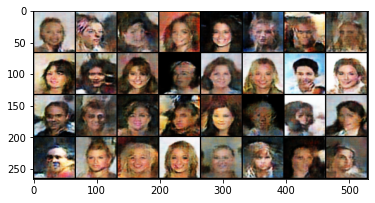

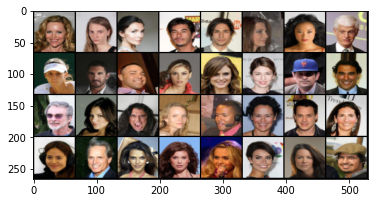

Epoch [2/100] Batch 1700/3166                   Loss D: -4.3949, loss G: 122.6855


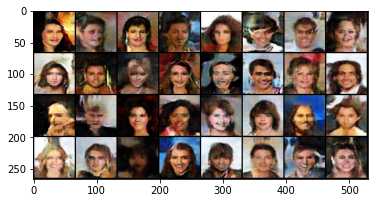

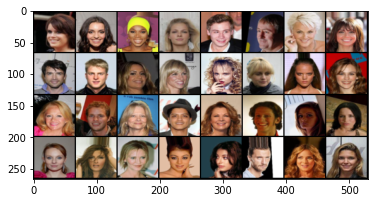

Epoch [2/100] Batch 1800/3166                   Loss D: -5.4297, loss G: 130.3719


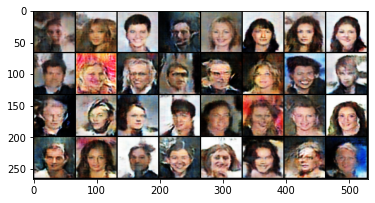

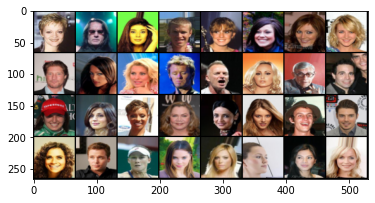

Epoch [2/100] Batch 1900/3166                   Loss D: -3.6800, loss G: 127.8694


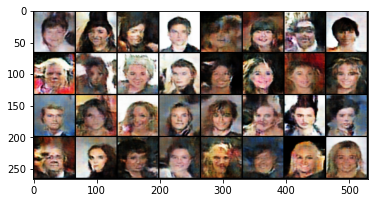

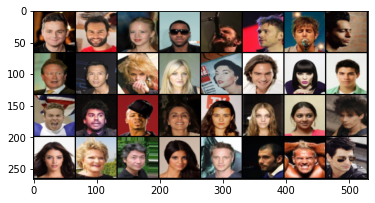

In [ ]:
fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)
opt_gen = optim.RMSprop(gen.parameters(), lr=LEARNING_RATE)
opt_critic = optim.RMSprop(critic.parameters(), lr=LEARNING_RATE)


gen.train()
critic.train()

for epoch in range(NUM_EPOCHS):
    # Target labels not needed! <3 unsupervised
    for batch_idx, (data, _) in enumerate(dataloader):
        data = data.to(device)
        cur_batch_size = data.shape[0]        

        # Train Critic: max E[critic(real)] - E[critic(fake)]
        
        for _ in range(CRITIC_ITERATIONS):
            noise = torch.randn(cur_batch_size, Z_DIM, 1, 1).to(device)
            fake = gen(noise)
            critic_real = critic(data).reshape(-1)
            critic_fake = critic(fake).reshape(-1)
            gp = gradient_penalty(critic, data, fake, device=device)
            loss_critic = -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP*gp
            critic.zero_grad()
            loss_critic.backward(retain_graph=True)
            opt_critic.step()


        # Train Generator: max E[critic(gen_fake)] <-> min -E[critic(gen_fake)]
        gen_fake = critic(fake).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        # Print losses occasionally and print to tensorboard
        if batch_idx % 100 == 0 and batch_idx > 0:
            gen.eval()
            critic.eval()
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(dataloader)} \
                  Loss D: {loss_critic:.4f}, loss G: {loss_gen:.4f}"
            )

            with torch.no_grad():
                gen.eval()
                fake = gen(noise)
                # take out (up to) 32 examples
                img_grid_real = torchvision.utils.make_grid(
                    data[:32], normalize=True
                )
                img_grid_fake = torchvision.utils.make_grid(
                    fake[:32], normalize=True
                ) 
                imshow(img_grid_fake)
                imshow(img_grid_real)

          
            gen.train()
